<a href="https://colab.research.google.com/github/keduog/llama3/blob/main/spiro_layer_head.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

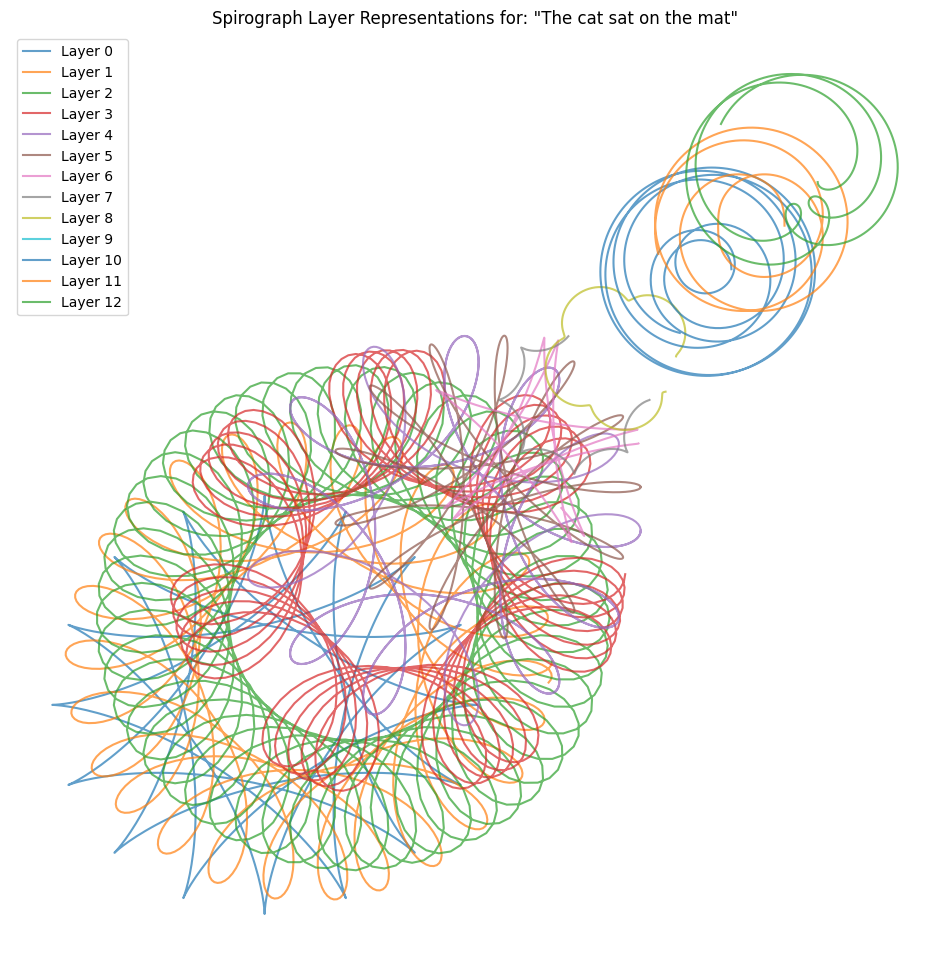

In [9]:
# Install required packages (if not already installed)
!pip install transformers scikit-learn matplotlib --quiet

import numpy as np
import matplotlib.pyplot as plt
from transformers import BertTokenizer, BertModel
import torch
from sklearn.decomposition import PCA

# Load pre-trained BERT model and tokenizer
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertModel.from_pretrained("bert-base-uncased", output_hidden_states=True)
model.eval()

def get_layer_embeddings(sentence):
    # Tokenize input sentence
    inputs = tokenizer(sentence, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)
        hidden_states = outputs.hidden_states  # Tuple of 13 layers: embeddings + 12 hidden layers

    # Mean pooling over tokens for each layer
    layer_embeddings = [torch.mean(layer.squeeze(0), dim=0).numpy() for layer in hidden_states]
    return layer_embeddings

def reduce_embeddings(embeddings):
    # Use PCA to reduce each layer embedding to 2D
    pca = PCA(n_components=2)
    return pca.fit_transform(embeddings)

def draw_spirograph(x_center, y_center, R, r, d, steps=1000):
    t = np.linspace(0, 2 * np.pi * 5, steps)
    x = (R - r) * np.cos(t) + d * np.cos((R - r) / r * t) + x_center
    y = (R - r) * np.sin(t) - d * np.sin((R - r) / r * t) + y_center
    return x, y

def plot_spirographs(sentence):
    layer_embeddings = get_layer_embeddings(sentence)
    reduced = reduce_embeddings(layer_embeddings)

    plt.figure(figsize=(12, 12))
    for i, coords in enumerate(reduced):
        R = 50 + int(coords[0] * 10)
        r = 10 + int(abs(coords[1]) * 5)
        d = 30
        x, y = draw_spirograph(i * 20, i * 20, R, r, d)
        plt.plot(x, y, label=f"Layer {i}", alpha=0.7)

    plt.title(f"Spirograph Layer Representations for: \"{sentence}\"")
    plt.axis("off")
    plt.legend()
    plt.show()

# Example usage
plot_spirographs("The cat sat on the mat")


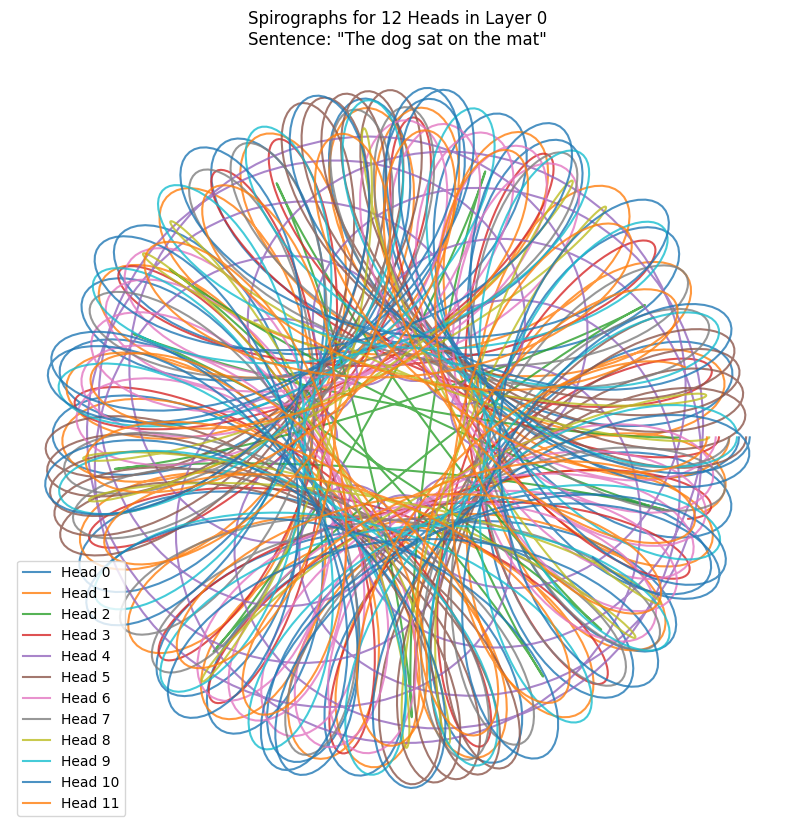

In [11]:
from transformers import BertModel, BertTokenizer
import torch
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertModel.from_pretrained("bert-base-uncased", output_hidden_states=True)
model.eval()

def extract_head_embeddings(sentence):
    inputs = tokenizer(sentence, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)
        hidden = outputs.hidden_states[1]  # Layer 0 output (batch_size, seq_len, hidden_dim)

    # Simulate "head" splitting from hidden_dim=768 into 12 heads (64-dim each)
    hidden = hidden.squeeze(0)  # (seq_len, 768)
    heads = hidden.view(hidden.size(0), 12, 64)  # (seq_len, 12 heads, 64 dim)
    head_embeddings = heads.mean(dim=0)  # (12 heads, 64 dim)

    # Project 64-dim head embeddings to 2D for visualization
    pca = PCA(n_components=2)
    reduced = pca.fit_transform(head_embeddings.numpy())  # (12 heads, 2)
    return reduced

def draw_spirograph(R, r, d, x_offset=0, y_offset=0, steps=1000):
    t = np.linspace(0, 2 * np.pi * 5, steps)
    x = (R - r) * np.cos(t) + d * np.cos((R - r) / r * t) + x_offset
    y = (R - r) * np.sin(t) - d * np.sin((R - r) / r * t) + y_offset
    return x, y

def plot_heads_spirograph(sentence):
    reduced = extract_head_embeddings(sentence)
    plt.figure(figsize=(10, 10))
    for i, (x_val, y_val) in enumerate(reduced):
        R = 40 + x_val * 10
        r = 10 + abs(y_val) * 5
        d = 20
        x, y = draw_spirograph(R, r, d)
        plt.plot(x, y, label=f"Head {i}", alpha=0.8)
    plt.title(f"Spirographs for 12 Heads in Layer 0\nSentence: \"{sentence}\"")
    plt.axis("off")
    plt.legend()
    plt.show()

# Example
plot_heads_spirograph("The dog sat on the mat")


Generating spirographs for: "The dog sat on the mat"


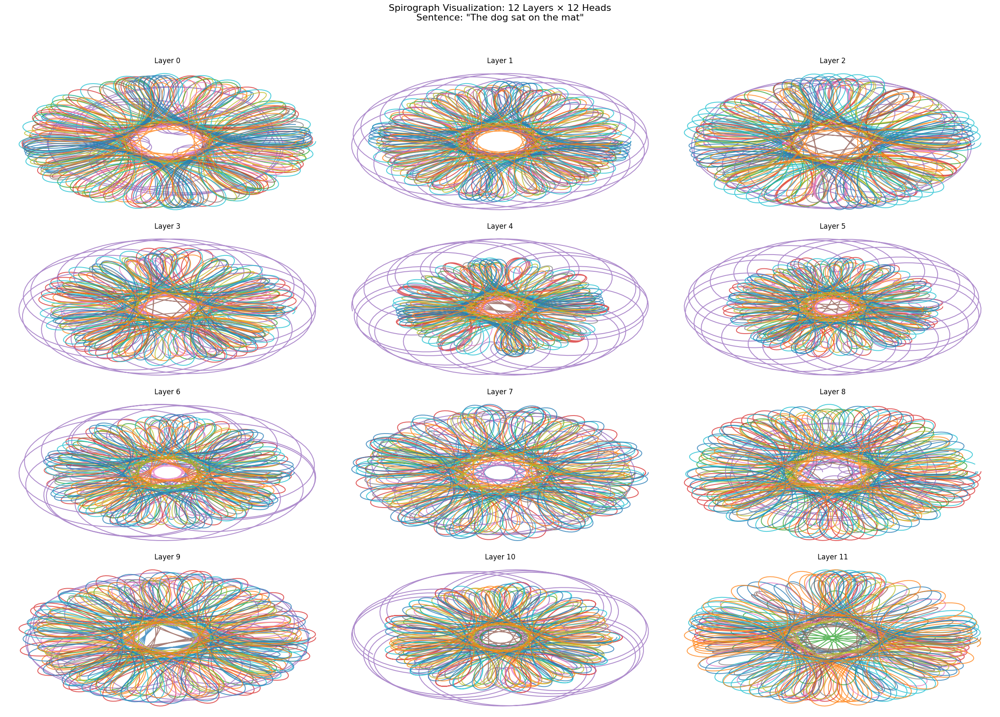

In [13]:
from transformers import BertModel, BertTokenizer
import torch
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# Load tokenizer and model
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertModel.from_pretrained("bert-base-uncased", output_hidden_states=True)
model.eval()

def extract_all_head_embeddings(sentence):
    inputs = tokenizer(sentence, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)
        hidden_states = outputs.hidden_states[1:]  # Skip embedding layer, take layers 1–12

    all_head_embeddings = []

    for layer_output in hidden_states:
        layer_output = layer_output.squeeze(0)  # (seq_len, 768)
        heads = layer_output.view(layer_output.size(0), 12, 64)  # (seq_len, 12, 64)
        mean_heads = heads.mean(dim=0)  # (12 heads, 64)
        all_head_embeddings.append(mean_heads.numpy())  # Append (12, 64) per layer

    return np.array(all_head_embeddings)  # Shape: (12 layers, 12 heads, 64)

def reduce_head_embeddings(head_embeddings):
    flat = head_embeddings.reshape(-1, 64)  # (144, 64)
    pca = PCA(n_components=2)
    reduced = pca.fit_transform(flat)
    return reduced.reshape(12, 12, 2)  # (12 layers, 12 heads, 2D)

def draw_spirograph(R, r, d, x_offset=0, y_offset=0, steps=1000):
    t = np.linspace(0, 2 * np.pi * 5, steps)
    x = (R - r) * np.cos(t) + d * np.cos((R - r) / r * t) + x_offset
    y = (R - r) * np.sin(t) - d * np.sin((R - r) / r * t) + y_offset
    return x, y

def plot_all_spirographs(sentence):
    print(f"Generating spirographs for: \"{sentence}\"")
    embeddings = extract_all_head_embeddings(sentence)
    reduced = reduce_head_embeddings(embeddings)

    fig, axs = plt.subplots(4, 3, figsize=(24, 18))  # 12 layers: 4x3 grid
    axs = axs.flatten()

    for layer in range(12):
        ax = axs[layer]
        ax.set_title(f"Layer {layer}", fontsize=12)
        ax.axis("off")

        for head in range(12):
            x_val, y_val = reduced[layer][head]
            R = 40 + x_val * 10
            r = 10 + abs(y_val) * 5
            d = 20
            x, y = draw_spirograph(R, r, d)
            ax.plot(x, y, alpha=0.75, label=f"Head {head}")

    plt.suptitle(f"Spirograph Visualization: 12 Layers × 12 Heads\nSentence: \"{sentence}\"", fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Example usage
plot_all_spirographs("hehehehe yhsjsds jsdhsjdhsj jshdjsdh")


In [14]:
# Install dependencies
!pip install transformers scikit-learn matplotlib --quiet

import numpy as np
import matplotlib.pyplot as plt
from transformers import BertModel, BertTokenizer
import torch
from sklearn.decomposition import PCA

# Load tokenizer and BERT model with hidden states
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")
model = BertModel.from_pretrained("bert-base-uncased", output_hidden_states=True)
model.eval()

# Step 1: Get all head embeddings (12 layers × 12 heads × 64)
def extract_all_head_embeddings(sentence):
    inputs = tokenizer(sentence, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs, output_hidden_states=True)
        hidden_states = outputs.hidden_states[1:]  # skip embedding layer

    all_head_embeddings = []

    for layer_output in hidden_states:
        layer_output = layer_output.squeeze(0)  # (seq_len, 768)
        heads = layer_output.view(layer_output.size(0), 12, 64)  # (seq_len, 12 heads, 64)
        mean_heads = heads.mean(dim=0)  # (12 heads, 64)
        all_head_embeddings.append(mean_heads.numpy())  # (12, 64)

    return np.array(all_head_embeddings)  # (12 layers, 12 heads, 64)

# Step 2: PCA reduction
def reduce_head_embeddings(head_embeddings):
    flat = head_embeddings.reshape(-1, 64)  # (144, 64)
    pca = PCA(n_components=2)
    reduced = pca.fit_transform(flat)
    return reduced.reshape(12, 12, 2)  # (12 layers, 12 heads, 2D)

# Step 3: Sentence quality scoring using [CLS] norm
def sentence_coherence_score(sentence):
    inputs = tokenizer(sentence, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)
        cls_embedding = outputs.last_hidden_state[:, 0, :]  # CLS token
    return torch.norm(cls_embedding).item()

# Step 4: Draw spirograph (distorted for low-quality input)
def draw_spirograph(R, r, d, x_offset=0, y_offset=0, steps=1000):
    t = np.linspace(0, 2 * np.pi * 5, steps)
    x = (R - r) * np.cos(t) + d * np.cos((R - r) / r * t) + x_offset
    y = (R - r) * np.sin(t) - d * np.sin((R - r) / r * t) + y_offset
    return x, y

def get_params_by_quality(x_val, y_val, score, threshold=7.5):
    if score < threshold:
        # Distort spirograph parameters randomly
        R = np.random.uniform(20, 100)
        r = np.random.uniform(5, 30)
        d = np.random.uniform(5, 60)
    else:
        R = 40 + x_val * 10
        r = 10 + abs(y_val) * 5
        d = 20
    return R, r, d

# Step 5: Final Plot Function
def plot_all_spirographs(sentence):
    print(f"Generating spirographs for: \"{sentence}\"")

    # Get semantic quality
    quality_score = sentence_coherence_score(sentence)
    print(f"Semantic coherence score: {quality_score:.2f}")

    # Get and reduce embeddings
    embeddings = extract_all_head_embeddings(sentence)
    reduced = reduce_head_embeddings(embeddings)

    # Plot
    fig, axs = plt.subplots(4, 3, figsize=(24, 18))
    axs = axs.flatten()

    for layer in range(12):
        ax = axs[layer]
        ax.set_title(f"Layer {layer}", fontsize=12)
        ax.axis("off")

        for head in range(12):
            x_val, y_val = reduced[layer][head]
            R, r, d = get_params_by_quality(x_val, y_val, quality_score)
            x, y = draw_spirograph(R, r, d)
            ax.plot(x, y, alpha=0.75)

    plt.suptitle(f"Spirograph Visualization: 12 Layers × 12 Heads\nSentence: \"{sentence}\"", fontsize=18)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


Generating spirographs for: "The cat sat on the mat"
Semantic coherence score: 14.15


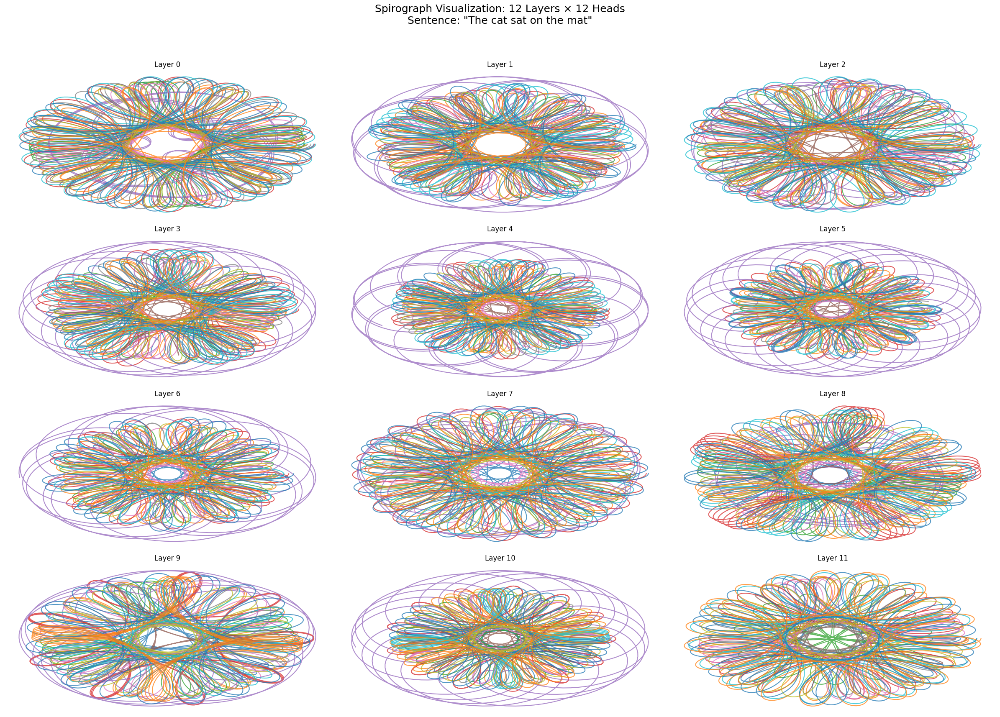

Generating spirographs for: "hehehehe yhsjsds jsdhsjdhsj jshdjsdh"
Semantic coherence score: 13.68


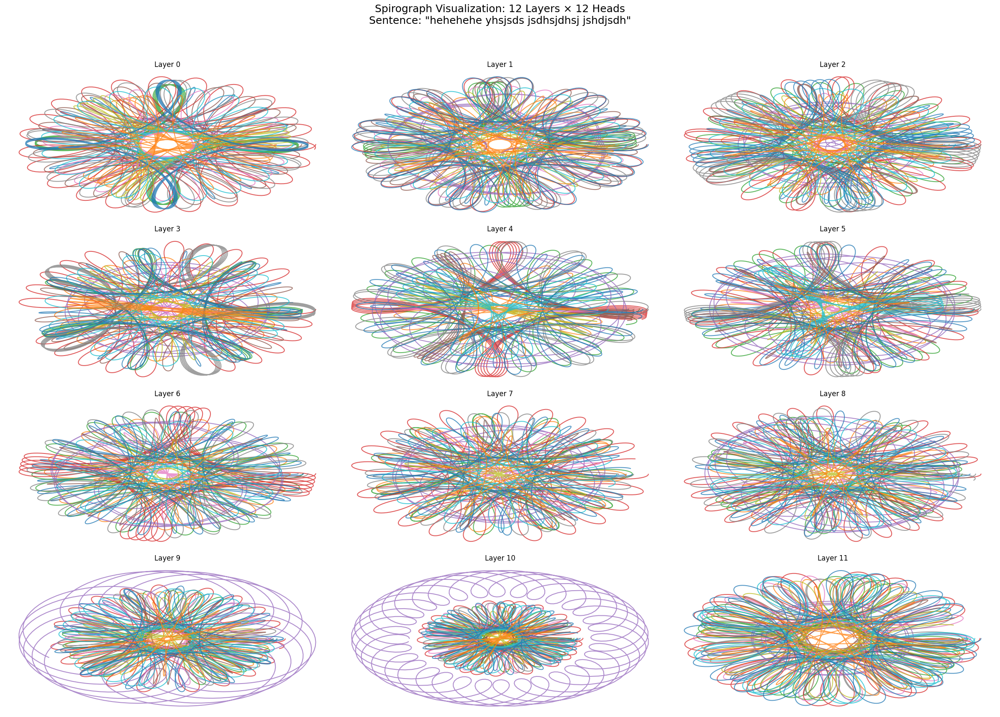

Generating spirographs for: "The dog sat on the mat"
Semantic coherence score: 14.15


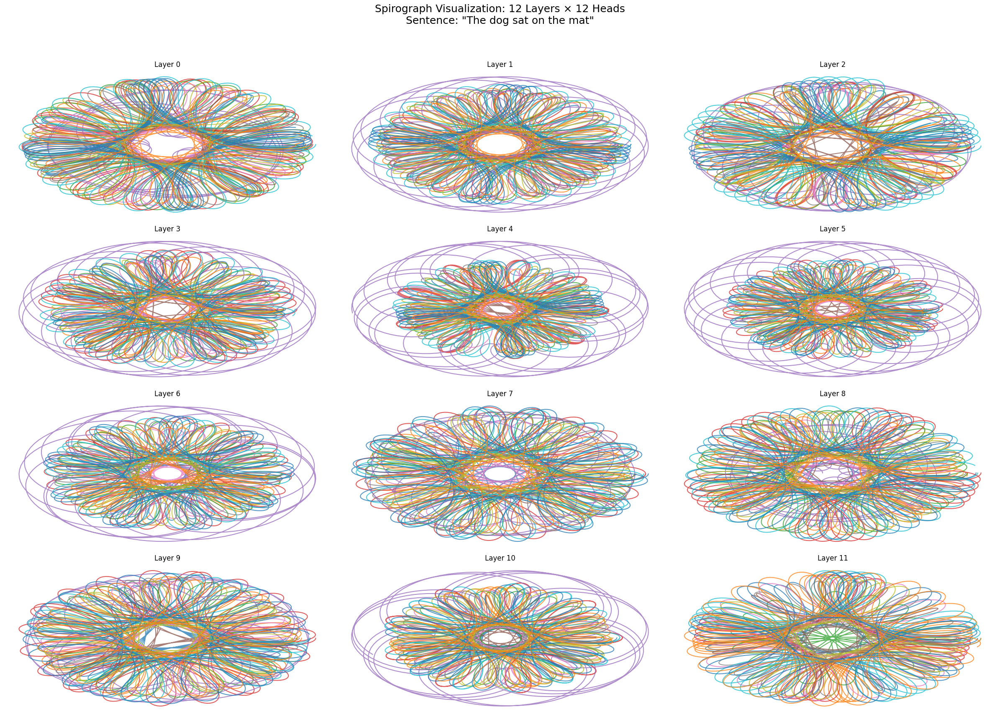

In [15]:
plot_all_spirographs("The cat sat on the mat")
plot_all_spirographs("hehehehe yhsjsds jsdhsjdhsj jshdjsdh")
plot_all_spirographs("The dog sat on the mat")


Generating spirographs for: "nature is beautiful"
Semantic coherence score: 14.31


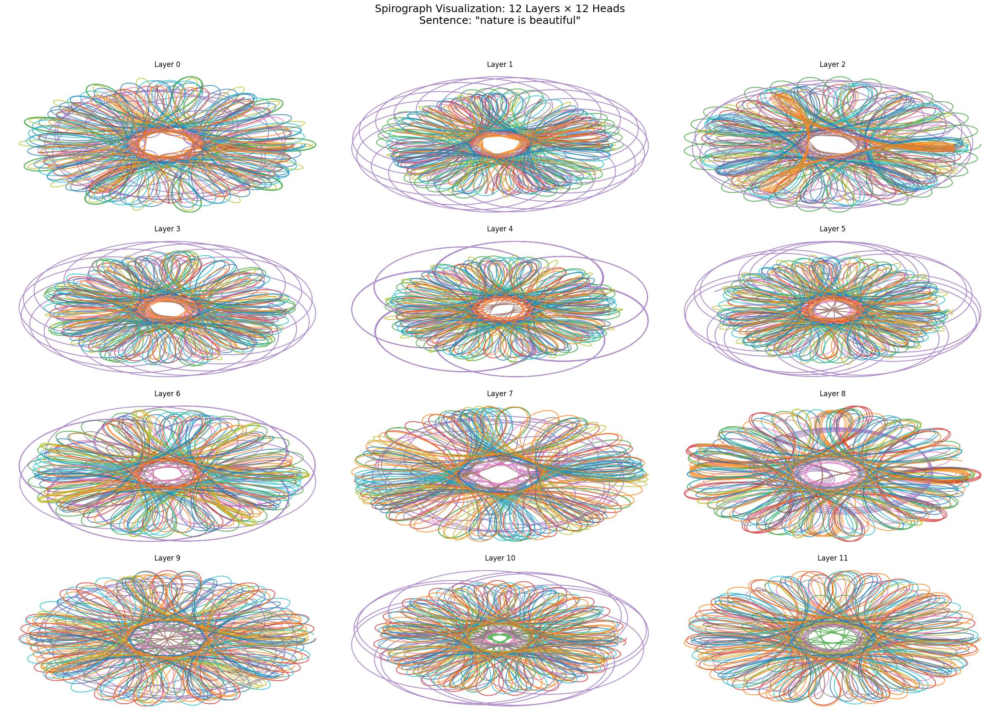

Generating spirographs for: "alasdlajdalskdja lajksdalsjdals lasjdalsdk"
Semantic coherence score: 14.36


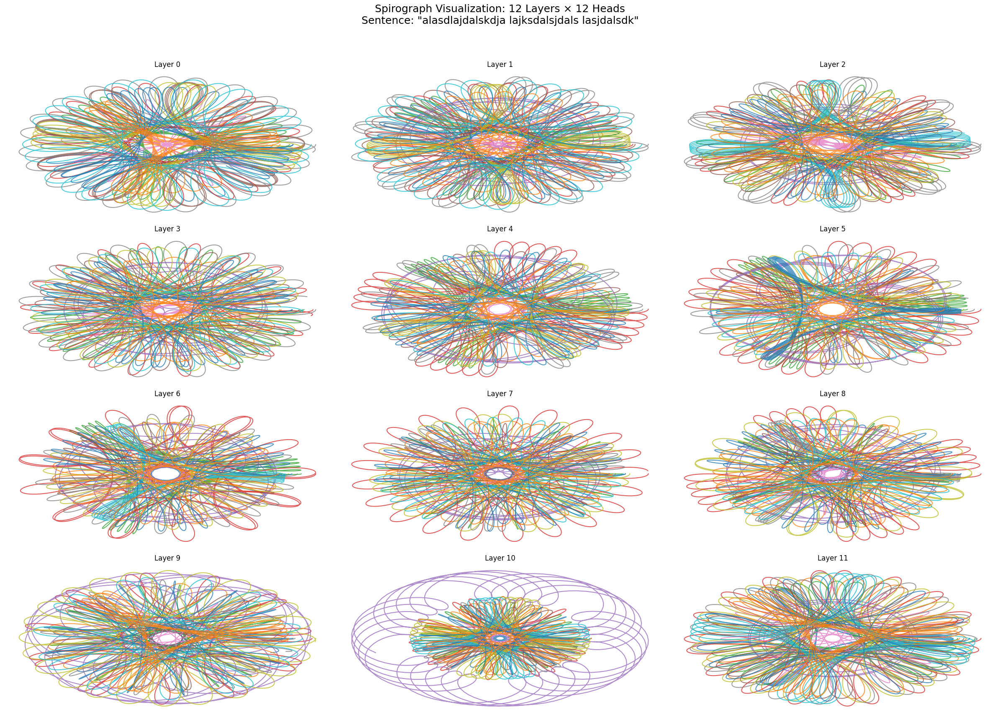

Generating spirographs for: "The dog sat on the mat"
Semantic coherence score: 14.15


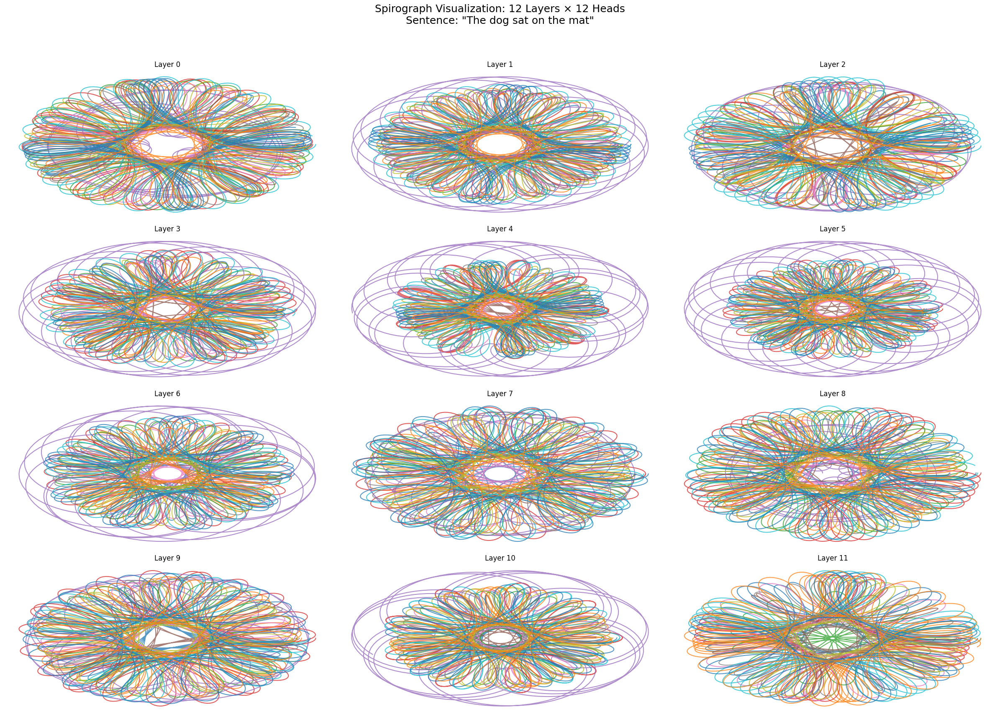

In [16]:
plot_all_spirographs("nature is beautiful")
plot_all_spirographs("alasdlajdalskdja lajksdalsjdals lasjdalsdk")
plot_all_spirographs("The dog sat on the mat")